In [3]:
import os
import path_file
os.chdir(os.path.dirname(os.path.dirname(path_file.__file__)))
os.getcwd()

'c:\\Users\\julia\\Desktop\\gasification'

In [4]:
import sys
import cantera as ct
import numpy as np
import scipy.optimize as opt
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from matplotlib.legend_handler import HandlerTuple

import phases
import feedstock as fs
import fuel as fu
import energy as en
import gasifier as gs

In [5]:
T0 = 298.15
P0 = ct.one_atm
N = 1.0+1E-5

ERs = np.arange(0.0, N, 0.01)

outs_by_ER1= []
outs_by_ER2= []
outs_by_ER3= []

In [6]:
#Li et al.
fuel1 = fs.create_fuel_stream(1, 
                              [55.56, 7.61, 35.45, 1.10, 0.29, 0.00], #ultimate db
                              14.41 / 100 , #ash db
                              71.78 / 100, #moist db
                              19.01) #HHV MJ/kg, d.b.

#Nisamaneenate et al.
fuel2 = fs.create_fuel_stream(1, 
                              [44.00, 7.64, 48.25, 0.11, 0.00, 0.00], #ultimate db
                              13.05 / 100, #ash db
                              73.38/ 100, #moist db
                              LHV=16.09) #LHV MJ/kg, d.b.
fuel2.set_HHV_from_LHV(16.09)

#Bhui et al.
fuel3 = fs.create_fuel_stream(1, #
                              [47.90, 6.30, 44.44, 1.20, 0.2, 0.00], #ultimate db
                              14.63 / 100, #ash db
                              71.95/ 100, #moist db
                              17.6) # HHV MJ/kg, d.b.
leg = ['RS-1 ', 'RS-2 ', 'RS-3 ']

In [7]:
stoichAir1= fs.create_air_from_ER(fuel1, 1.0)
stoichAirMass1 = stoichAir1.get_mass()
stoichOxygen1 = fs.create_O2_from_ER(fuel1, 1.0)
stoichOxygenMass11 = stoichOxygen1.get_mass()

for i, er in enumerate(ERs):
    air1 = fs.create_air_from_ER(fuel1, er)
    outlet = gs.gasify_nonisot(fuel1, air1, T0=T0, P=P0, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_ER1.append(outlet)


In [8]:
stoichAir2= fs.create_air_from_ER(fuel2, 1.0)
stoichAirMass2 = stoichAir2.get_mass()
stoichOxygen2 = fs.create_O2_from_ER(fuel2, 1.0)
stoichOxygenMass12 = stoichOxygen2.get_mass()

for i, er in enumerate(ERs):
    air2 = fs.create_air_from_ER(fuel2, er)
    outlet = gs.gasify_nonisot(fuel2, air2, T0=T0, P=P0, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_ER2.append(outlet)

In [9]:
stoichAir3= fs.create_air_from_ER(fuel3, 1.0)
stoichAirMass3 = stoichAir3.get_mass()
stoichOxygen3 = fs.create_O2_from_ER(fuel3, 1.0)
stoichOxygenMass13 = stoichOxygen3.get_mass()

for i, er in enumerate(ERs):
    air3 = fs.create_air_from_ER(fuel3, er)
    outlet = gs.gasify_nonisot(fuel3, air3, T0=T0, P=P0, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_ER3.append(outlet)

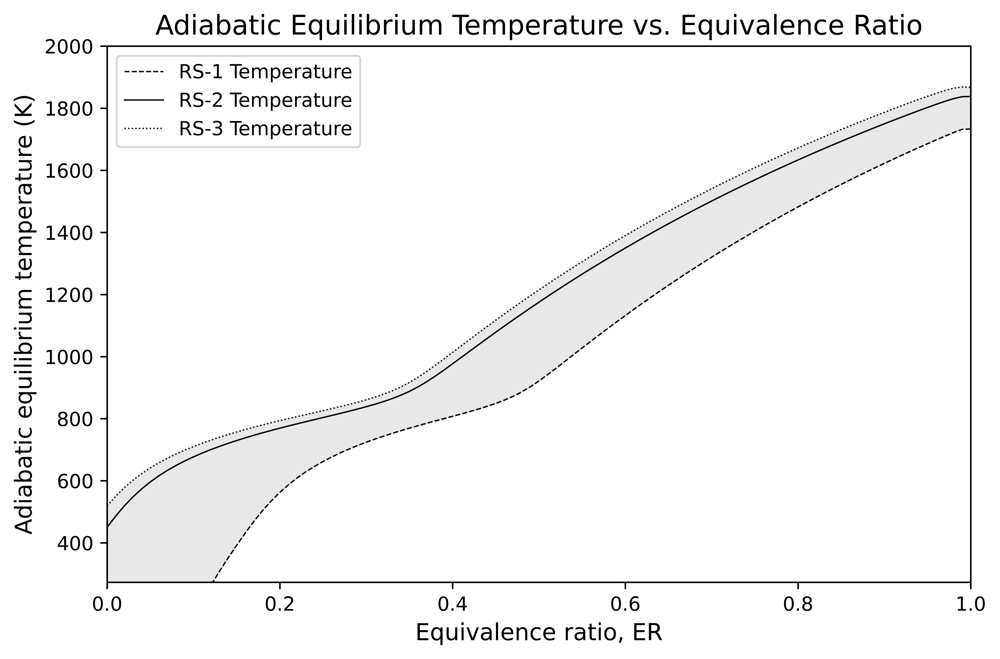

In [10]:
fig1, ax1a = plt.subplots(figsize=(8, 5), dpi=1000)

ax1a.plot(ERs, [out.T for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'Temperature', color='black')
ax1a.plot(ERs, [out.T for out in outs_by_ER2],'-',  linewidth=0.7, label=leg[1]+'Temperature', color='black')
ax1a.plot(ERs, [out.T for out in outs_by_ER3], ':', linewidth=0.7, label=leg[2]+'Temperature', color='black')

ax1a.fill_between(ERs, [out.T for out in outs_by_ER1], [out.T for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax1a.fill_between(ERs, [out.T for out in outs_by_ER2], [out.T for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax1a.set_xlabel('Equivalence ratio, ER', fontsize=12)
ax1a.set_ylabel('Adiabatic equilibrium temperature (K)', fontsize=12)
ax1a.set_xlim(0.0, 1.0)
ax1a.set_ylim(273, 2000)
#ax1a.grid(True, linestyle='--', alpha=0.7, linewidth=0.7)
ax1a.legend(loc='best', fontsize=10)
ax1a.tick_params(axis='both', which='major', labelsize=10)

plt.title('Adiabatic Equilibrium Temperature vs. Equivalence Ratio', fontsize=14)

plt.savefig('figures/sensit_Temp_ER.png', bbox_inches='tight')

plt.show()

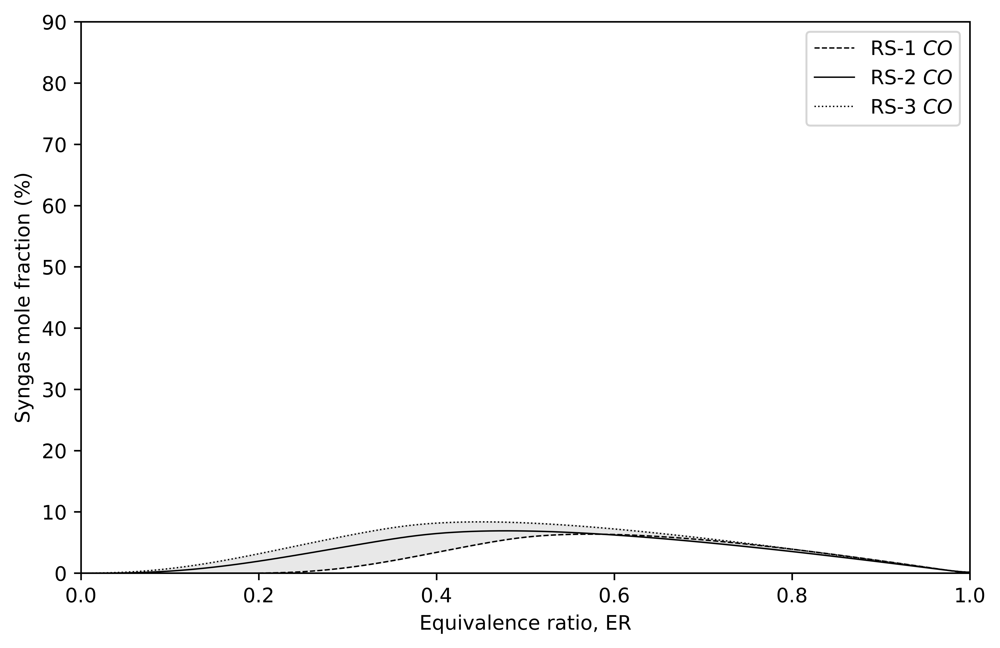

In [11]:
fig2_1, ax2_1a = plt.subplots(figsize=(8,5), dpi=1000)
siz = 90
ax2_1a.plot(ERs, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'$CO$', color='black')
ax2_1a.plot(ERs, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'$CO$', color='black')
ax2_1a.plot(ERs, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'$CO$', color='black')

ax2_1a.fill_between(ERs, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_ER1], 
                  [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax2_1a.fill_between(ERs, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_ER2], 
                  [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax2_1a.legend(loc='best')
ax2_1a.set_xlabel('Equivalence ratio, ER')
ax2_1a.set_ylabel('Syngas mole fraction (%)')
ax2_1a.set_xlim(0, 1)
ax2_1a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_ER_CO.jpg')
plt.show()

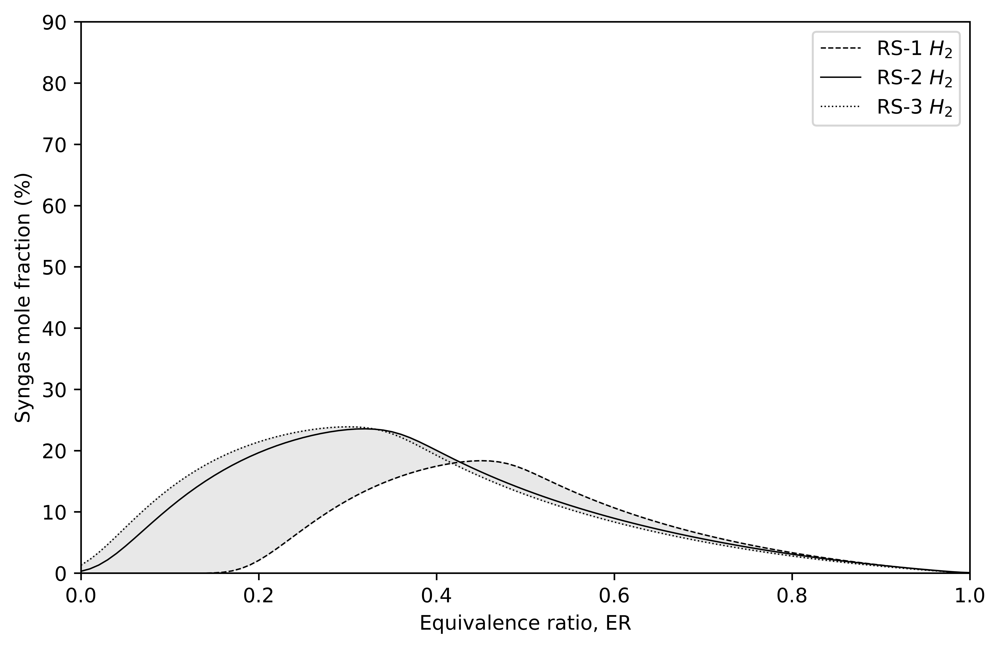

In [12]:
fig2_2, ax2_2a = plt.subplots(figsize=(8,5), dpi=1000)
ax2_2a.plot(ERs, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'$H_2$', color='black')
ax2_2a.plot(ERs, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'$H_2$', color='black')
ax2_2a.plot(ERs, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'$H_2$', color='black')

ax2_2a.fill_between(ERs, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_ER1], 
                  [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax2_2a.fill_between(ERs, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_ER2], 
                  [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax2_2a.legend(loc='best')
ax2_2a.set_xlabel('Equivalence ratio, ER')
ax2_2a.set_ylabel('Syngas mole fraction (%)')
ax2_2a.set_xlim(0, 1)
ax2_2a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_ER_H2.jpg')
plt.show()

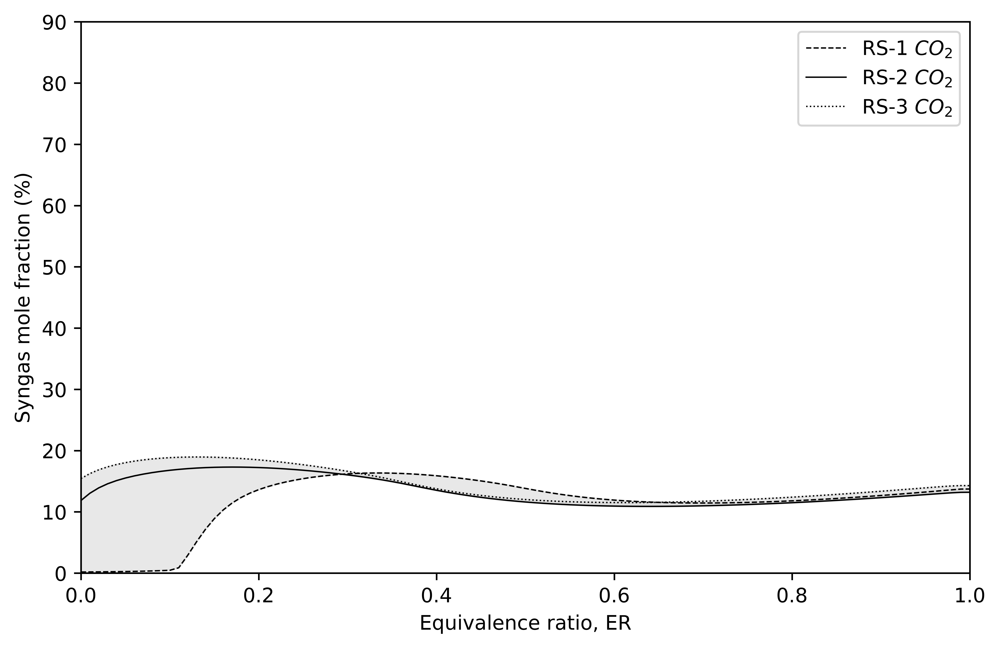

In [13]:
fig2_3, ax2_3a = plt.subplots(figsize=(8,5), dpi=1000)
ax2_3a.plot(ERs, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'$CO_2$', color='black')
ax2_3a.plot(ERs, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'$CO_2$', color='black')
ax2_3a.plot(ERs, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'$CO_2$', color='black')

ax2_3a.fill_between(ERs, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_ER1], 
                 [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax2_3a.fill_between(ERs, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_ER2], 
                  [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax2_3a.legend(loc='best')
ax2_3a.set_xlabel('Equivalence ratio, ER')
ax2_3a.set_ylabel('Syngas mole fraction (%)')
ax2_3a.set_xlim(0, 1)
ax2_3a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_ER_CO2.jpg')
plt.show()

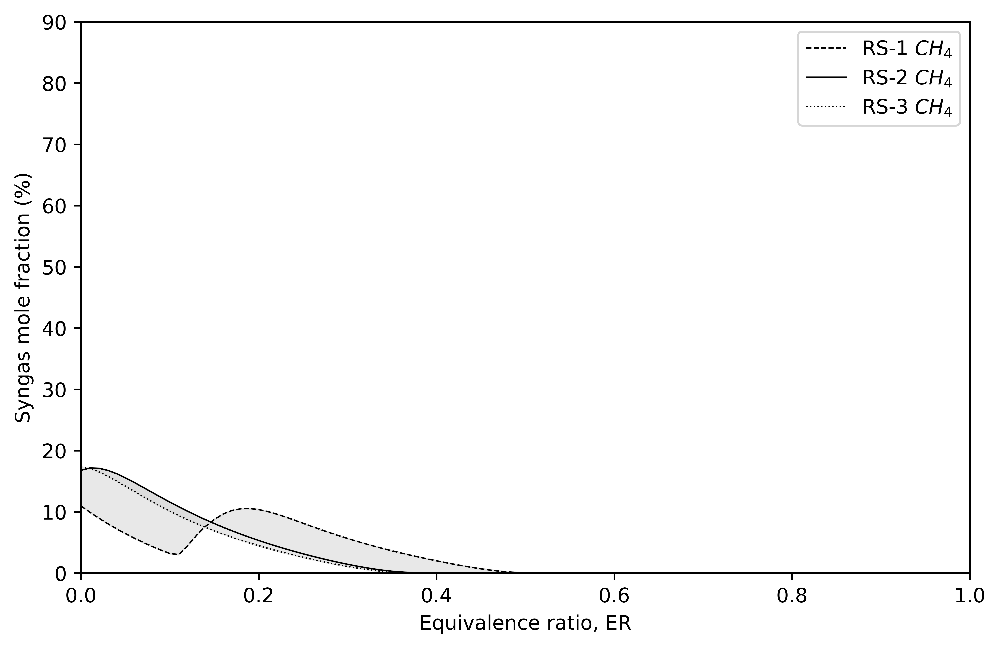

In [14]:
fig2_4, ax2_4a = plt.subplots(figsize=(8,5), dpi=1000)
ax2_4a.plot(ERs, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'$CH_4$', color='black')
ax2_4a.plot(ERs, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'$CH_4$', color='black')
ax2_4a.plot(ERs, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'$CH_4$', color='black')

ax2_4a.fill_between(ERs,  [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_ER1], 
                 [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax2_4a.fill_between(ERs,  [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_ER2], 
                  [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax2_4a.legend(loc='best')
ax2_4a.set_xlabel('Equivalence ratio, ER')
ax2_4a.set_ylabel('Syngas mole fraction (%)')
ax2_4a.set_xlim(0, 1)
ax2_4a.set_ylim(0, siz)
plt.savefig('figures/sensit_Compos_ER_CH4.jpg')
plt.show()

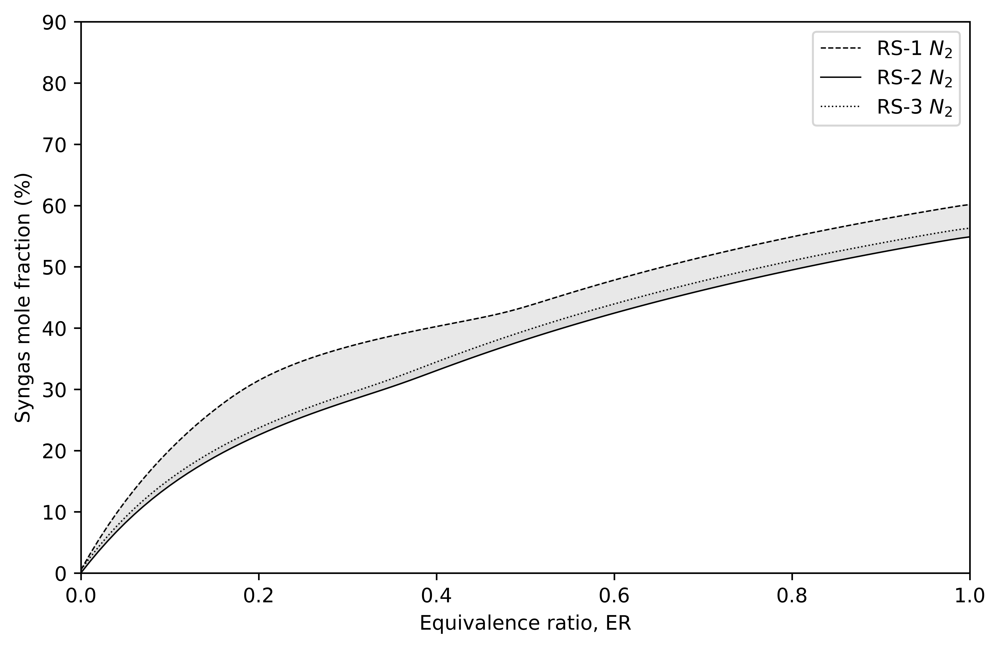

In [15]:
fig2_5, ax2_5a = plt.subplots(figsize=(8,5), dpi=1000)
ax2_5a.plot(ERs, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'$N_2$', color='black')
ax2_5a.plot(ERs, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'$N_2$', color='black')
ax2_5a.plot(ERs, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'$N_2$', color='black')

ax2_5a.fill_between(ERs, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_ER1], 
                  [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax2_5a.fill_between(ERs, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_ER2], 
                  [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax2_5a.legend(loc='best')
ax2_5a.set_xlabel('Equivalence ratio, ER')
ax2_5a.set_ylabel('Syngas mole fraction (%)')
ax2_5a.set_xlim(0, 1)
ax2_5a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_ER_N2.jpg')
plt.show()

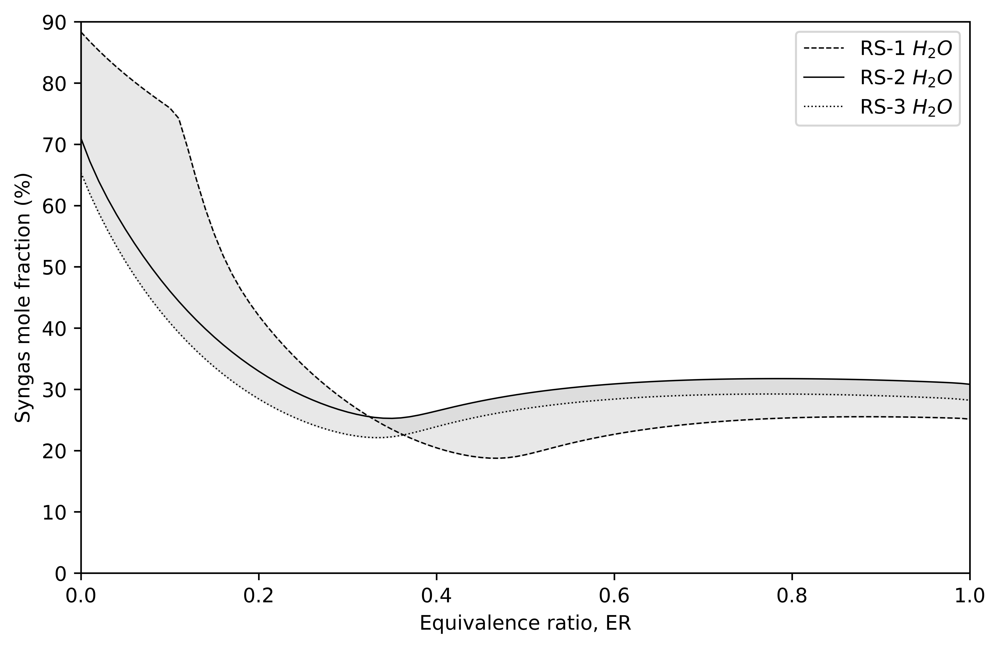

In [16]:
fig2_6, ax2_6a = plt.subplots(figsize=(8,5), dpi=1000)
ax2_6a.plot(ERs, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'$H_2O$', color='black')
ax2_6a.plot(ERs, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'$H_2O$', color='black')
ax2_6a.plot(ERs, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'$H_2O$', color='black')

ax2_6a.fill_between(ERs, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_ER1], 
                  [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax2_6a.fill_between(ERs, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_ER2], 
                  [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax2_6a.legend(loc='best')
ax2_6a.set_xlabel('Equivalence ratio, ER')
ax2_6a.set_ylabel('Syngas mole fraction (%)')
ax2_6a.set_xlim(0, 1)
ax2_6a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_ER_H2O.jpg')
plt.show()

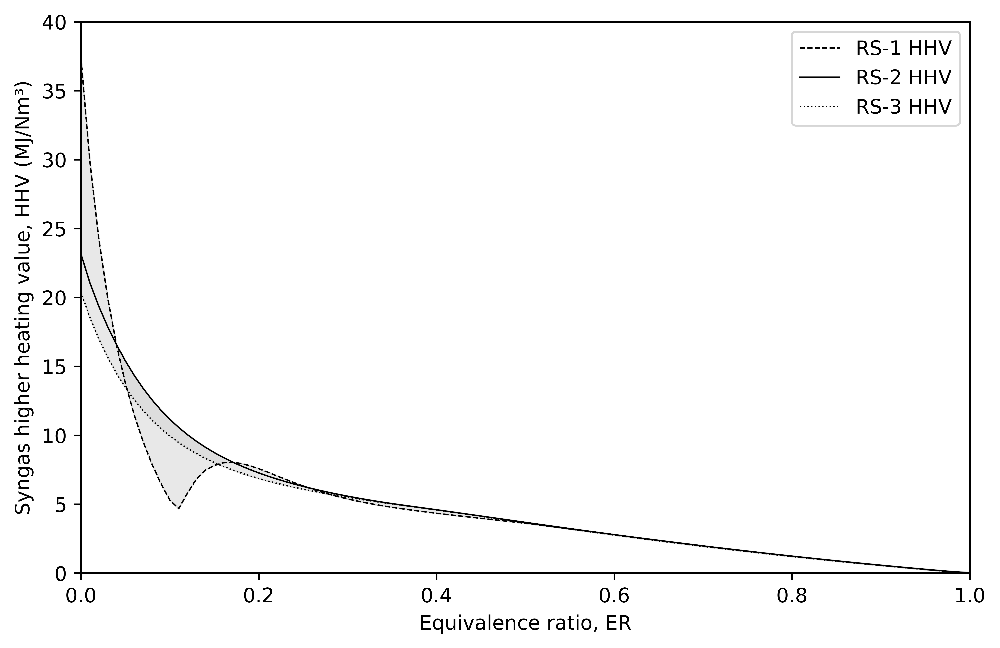

In [17]:
fig3_1, ax3_1a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax3_1a.set_xlim(0, 1)
ax3_1a.set_ylim(0, 40)

ax3_1a.plot(ERs, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'HHV', color='black')
ax3_1a.plot(ERs, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'HHV', color='black')
ax3_1a.plot(ERs, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'HHV', color='black')

ax3_1a.fill_between(ERs, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_ER1], 
                  [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax3_1a.fill_between(ERs, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_ER2], 
                  [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax3_1a.legend(loc='best')
ax3_1a.set_xlabel('Equivalence ratio, ER')
ax3_1a.set_ylabel('Syngas higher heating value, HHV (MJ/Nm³)')

plt.savefig('figures/sensit_Eff_ER_HHV.jpg')
plt.show()

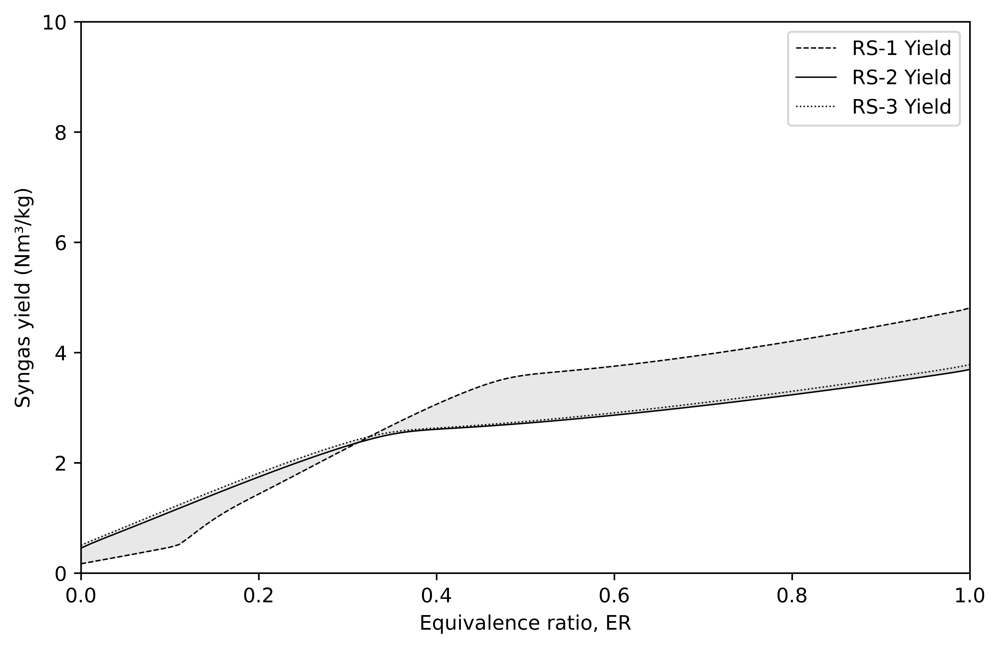

In [18]:
fig3_2, ax3_2a = plt.subplots(figsize=(8,5), dpi=1000)
    
ax3_2a.set_xlim(0, 1)
ax3_2a.set_ylim(0, 10)
    
ax3_2a.set_xlabel('Equivalence ratio, ER')
ax3_2a.set_ylabel('Syngas yield (Nm³/kg)')

ax3_2a.plot(ERs, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'Yield', color='black')
ax3_2a.plot(ERs, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'Yield', color='black')
ax3_2a.plot(ERs, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'Yield', color='black')

ax3_2a.fill_between(ERs, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_ER1], 
                  [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax3_2a.fill_between(ERs, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_ER2], 
                  [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax3_2a.legend(loc='best')
plt.savefig('figures/sensit_Eff_ER_Yield.jpg')
plt.show()

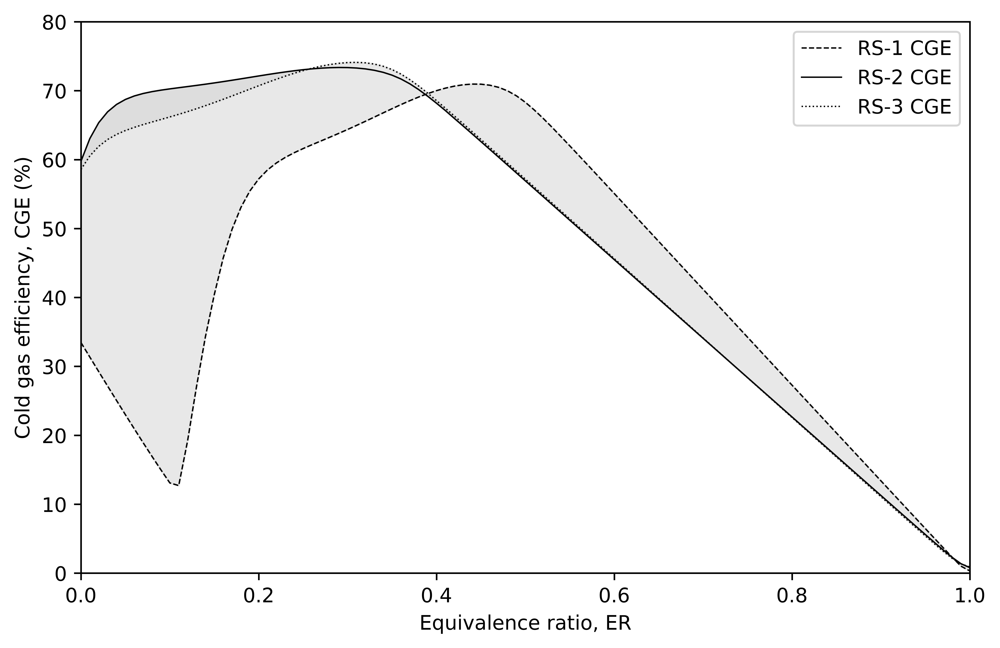

In [19]:
fig3_3, ax3_3a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax3_3a.set_xlim(0, 1)
ax3_3a.set_ylim(0, 80)

ax3_3a.plot(ERs, [100*out.get_syngas_CGE() for out in outs_by_ER1], '--',  linewidth=0.7, label=leg[0]+'CGE', color='black')
ax3_3a.plot(ERs, [100*out.get_syngas_CGE() for out in outs_by_ER2], '-',  linewidth=0.7, label=leg[1]+'CGE', color='black')
ax3_3a.plot(ERs, [100*out.get_syngas_CGE() for out in outs_by_ER3], ':',  linewidth=0.7, label=leg[2]+'CGE', color='black')

ax3_3a.fill_between(ERs, [100*out.get_syngas_CGE() for out in outs_by_ER1], 
                  [100*out.get_syngas_CGE() for out in outs_by_ER2], color='lightgray', alpha=0.5)
ax3_3a.fill_between(ERs, [100*out.get_syngas_CGE() for out in outs_by_ER2], 
                  [100*out.get_syngas_CGE() for out in outs_by_ER3], color='lightgray', alpha=0.5)

ax3_3a.legend(loc='best')
ax3_3a.set_xlabel('Equivalence ratio, ER')
ax3_3a.set_ylabel('Cold gas efficiency, CGE (%)')

plt.savefig('figures/sensit_Eff_ER_CGE.jpg')
plt.show()

In [20]:
optAir1 = fs.create_air_from_ER(fuel1, 0.3)
optAir2 = fs.create_air_from_ER(fuel2, 0.3)
optAir3 = fs.create_air_from_ER(fuel3, 0.3)

In [64]:
Ps = np.arange(0.1, 10+1E-9, 0.1) * ct.one_atm
outs_by_P1 = []

for i, p in enumerate(Ps):
    outlet = gs.gasify_nonisot(fuel1, optAir1, T0=T0, P=p, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_P1.append(outlet)

In [65]:
outs_by_P2 = []
for i, p in enumerate(Ps):
    outlet = gs.gasify_nonisot(fuel2, optAir2, T0=T0, P=p, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_P2.append(outlet)

In [66]:
outs_by_P3 = []   
for i, p in enumerate(Ps):
    outlet = gs.gasify_nonisot(fuel3, optAir3, T0=T0, P=p, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_P3.append(outlet)

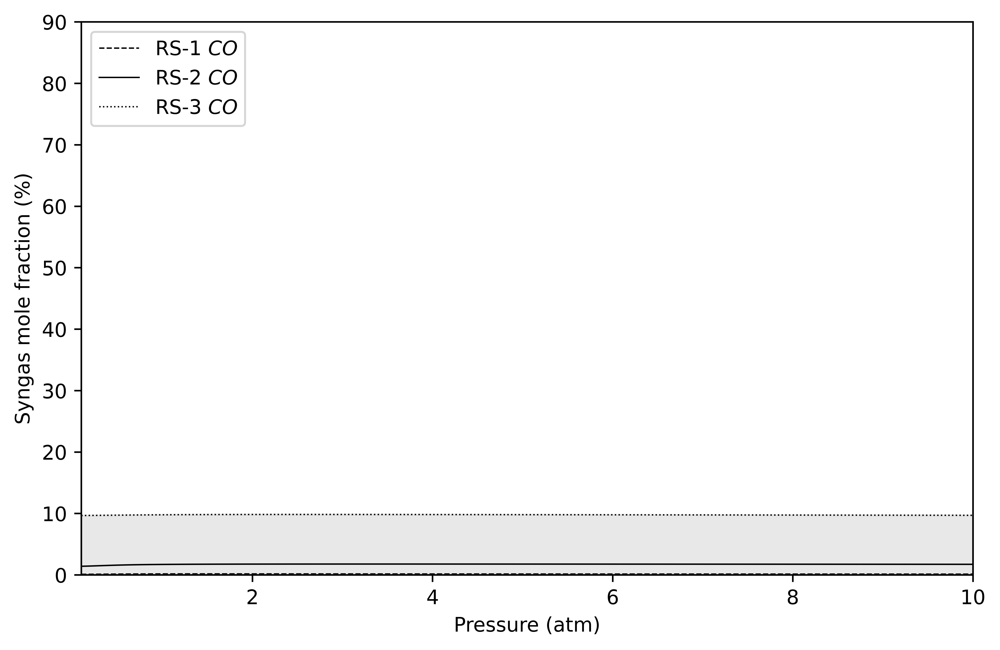

In [67]:
fig4_1, ax4_1a = plt.subplots(figsize=(8,5), dpi=1000)
ax4_1a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+'$CO$', color='black')
ax4_1a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+'$CO$', color='black')
ax4_1a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+'$CO$', color='black')

ax4_1a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_P1], 
                  [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax4_1a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_P2], 
                  [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax4_1a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax4_1a.legend(loc='upper left')
ax4_1a.set_xlabel('Pressure (atm)')
ax4_1a.set_ylabel('Syngas mole fraction (%)')
ax4_1a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_P_CO.jpg')
plt.show()

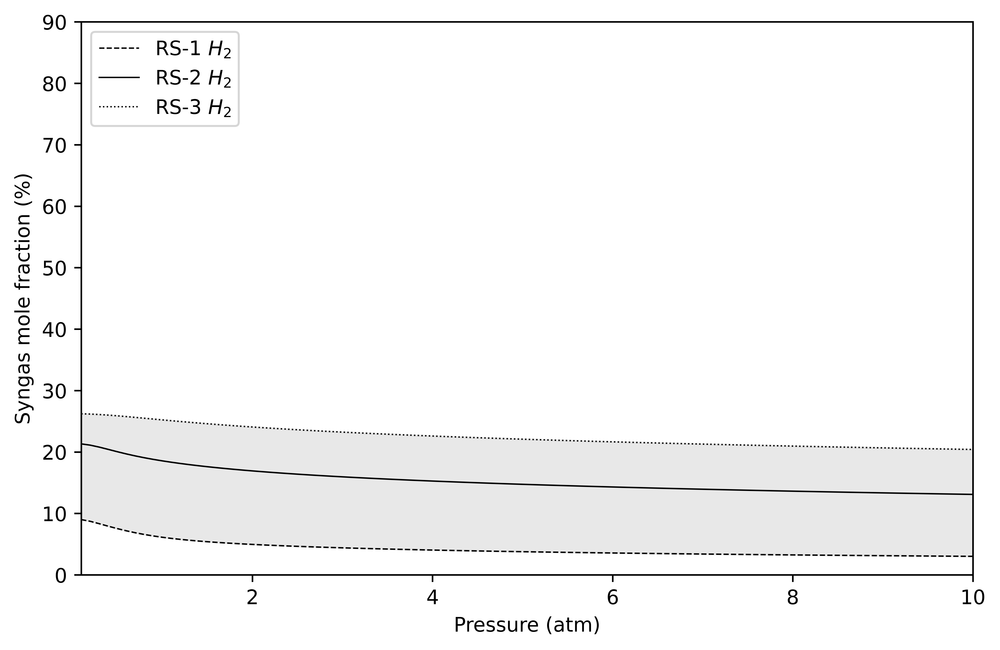

In [68]:
fig4_2, ax4_2a = plt.subplots(figsize=(8,5), dpi=1000)
ax4_2a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+'$H_2$', color='black')
ax4_2a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+'$H_2$', color='black')
ax4_2a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+'$H_2$', color='black')

ax4_2a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_P1], 
                 [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax4_2a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_P2], 
                  [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax4_2a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax4_2a.legend(loc='upper left')
ax4_2a.set_xlabel('Pressure (atm)')
ax4_2a.set_ylabel('Syngas mole fraction (%)')
ax4_2a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_P_H2.jpg')
plt.show()

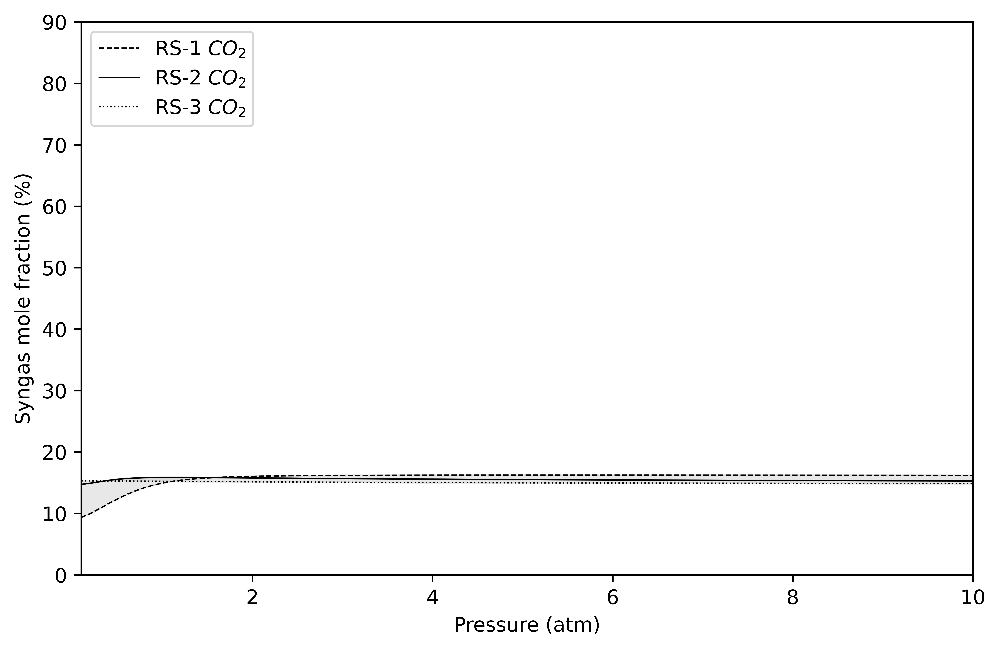

In [69]:
fi4_3, ax4_3a = plt.subplots(figsize=(8,5), dpi=1000)
ax4_3a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+'$CO_2$', color='black')
ax4_3a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+'$CO_2$', color='black')
ax4_3a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+'$CO_2$', color='black')

ax4_3a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_P1],
                  [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax4_3a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_P2], 
                  [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax4_3a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax4_3a.legend(loc='upper left')
ax4_3a.set_xlabel('Pressure (atm)')
ax4_3a.set_ylabel('Syngas mole fraction (%)')
ax4_3a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_P_CO2.jpg')
plt.show()

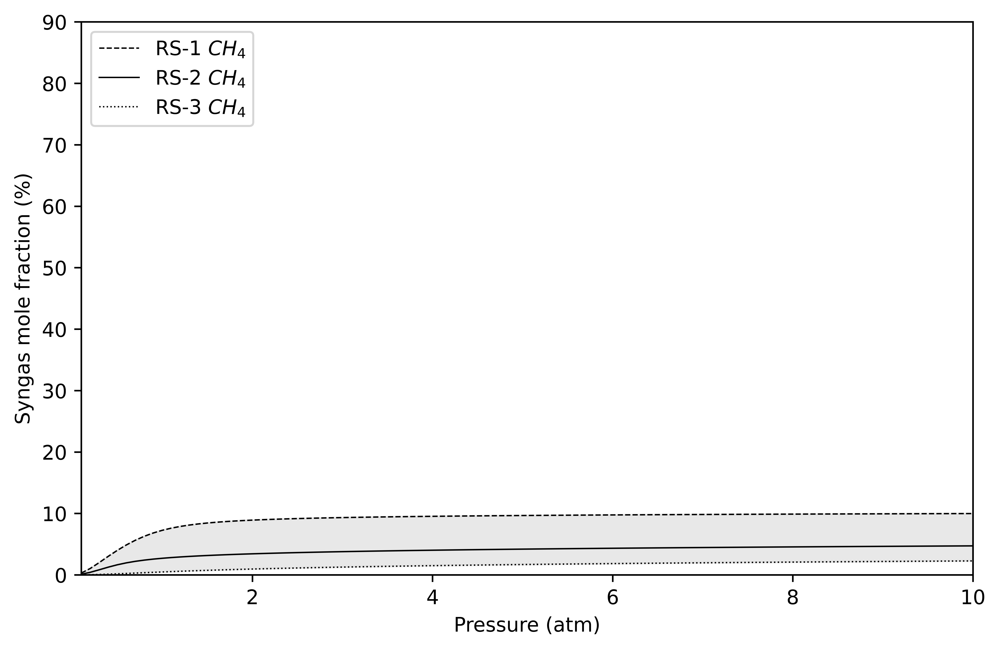

In [70]:
fig4_4, ax4_4a = plt.subplots(figsize=(8,5), dpi=1000)
ax4_4a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+'$CH_4$', color='black')
ax4_4a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+'$CH_4$', color='black')
ax4_4a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+'$CH_4$', color='black')

ax4_4a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_P1],
                  [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax4_4a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_P2], 
                  [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax4_4a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax4_4a.legend(loc='upper left')
ax4_4a.set_xlabel('Pressure (atm)')
ax4_4a.set_ylabel('Syngas mole fraction (%)')
ax4_4a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_P_CH4.jpg')
plt.show()

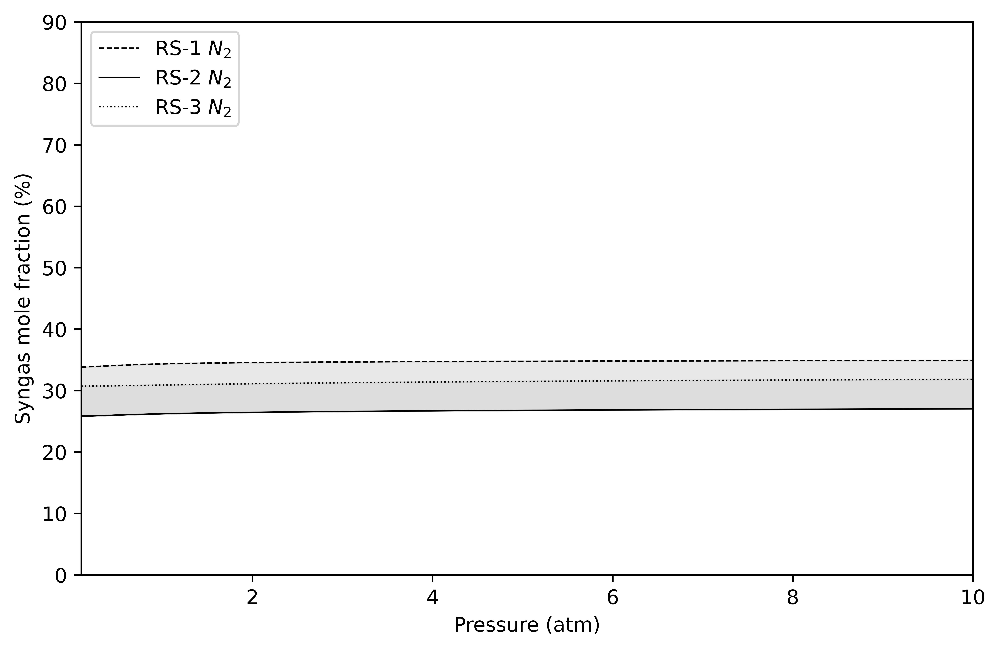

In [71]:
fig4_5, ax4_5a = plt.subplots(figsize=(8,5), dpi=1000)
ax4_5a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+'$N_2$', color='black')
ax4_5a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+'$N_2$', color='black')
ax4_5a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+'$N_2$', color='black')

ax4_5a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_P1],
                  [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax4_5a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_P2], 
                  [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax4_5a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax4_5a.legend(loc='upper left')
ax4_5a.set_xlabel('Pressure (atm)')
ax4_5a.set_ylabel('Syngas mole fraction (%)')
ax4_5a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_P_N2.jpg')
plt.show()

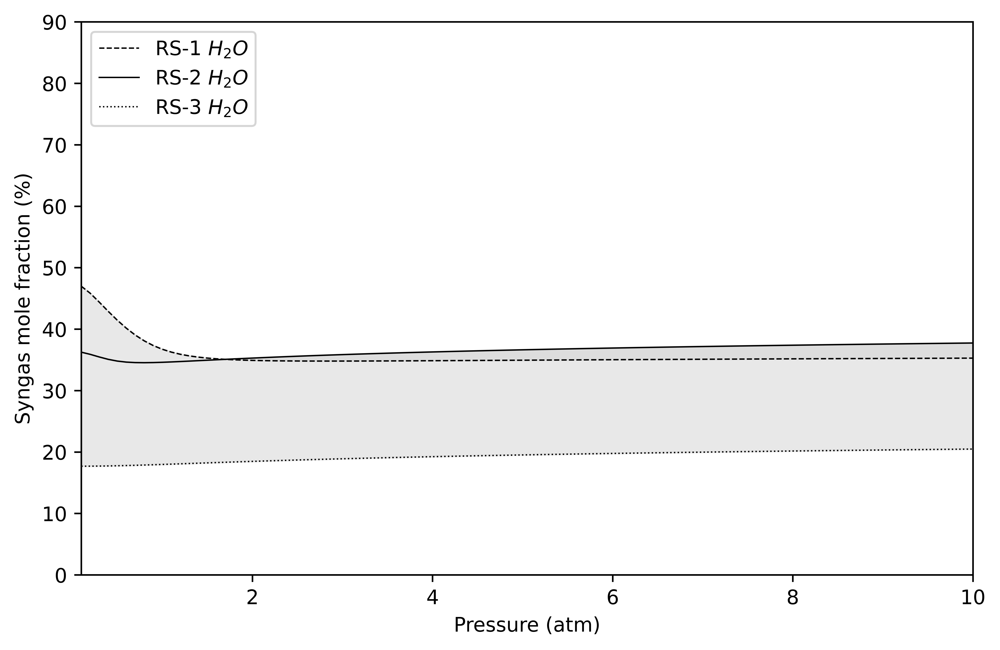

In [72]:
fig4_6, ax4_6a = plt.subplots(figsize=(8,5), dpi=1000)
ax4_6a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+'$H_2O$', color='black')
ax4_6a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+'$H_2O$', color='black')
ax4_6a.plot(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+'$H_2O$', color='black')

ax4_6a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_P1],
                  [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax4_6a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_P2], 
                  [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax4_6a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax4_6a.legend(loc='upper left')
ax4_6a.set_xlabel('Pressure (atm)')
ax4_6a.set_ylabel('Syngas mole fraction (%)')
ax4_6a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_P_H2O.jpg')
plt.show()

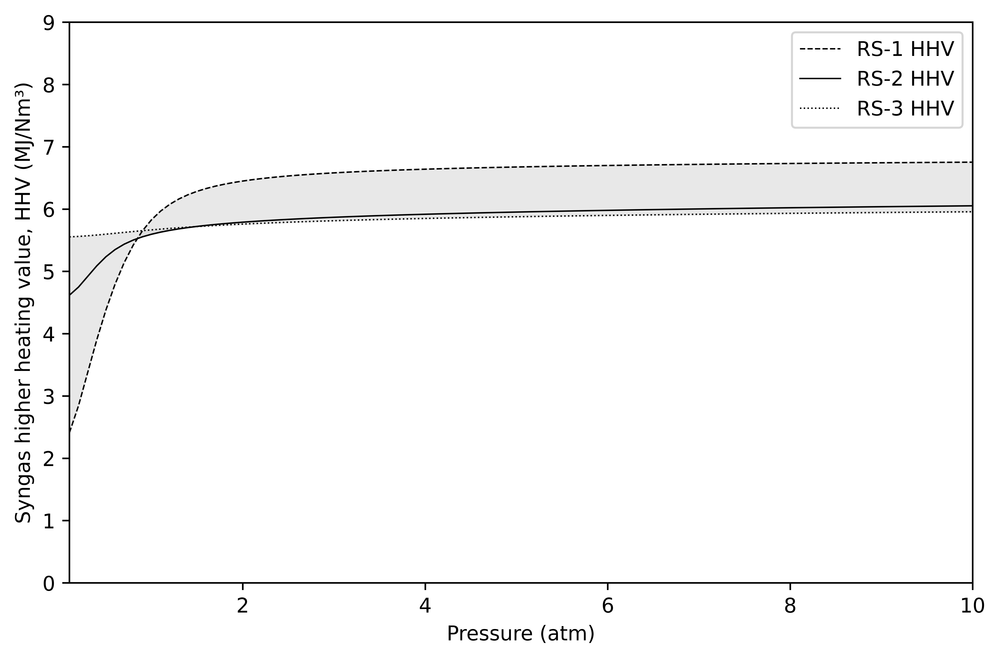

In [73]:
fig5_1, ax5_1a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax5_1a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax5_1a.set_ylim(0, 9)

ax5_1a.plot(Ps/ct.one_atm, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+"HHV", color='black')
ax5_1a.plot(Ps/ct.one_atm, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+"HHV", color='black')
ax5_1a.plot(Ps/ct.one_atm, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+"HHV", color='black')

ax5_1a.fill_between(Ps/ct.one_atm, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_P1], 
                  [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax5_1a.fill_between(Ps/ct.one_atm, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_P2], 
                   [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax5_1a.legend(loc='best')
ax5_1a.set_xlabel("Pressure (atm)")
ax5_1a.set_ylabel("Syngas higher heating value, HHV (MJ/Nm³)")

plt.savefig('figures/sensit_Eff_P_HHV.jpg')
plt.show()

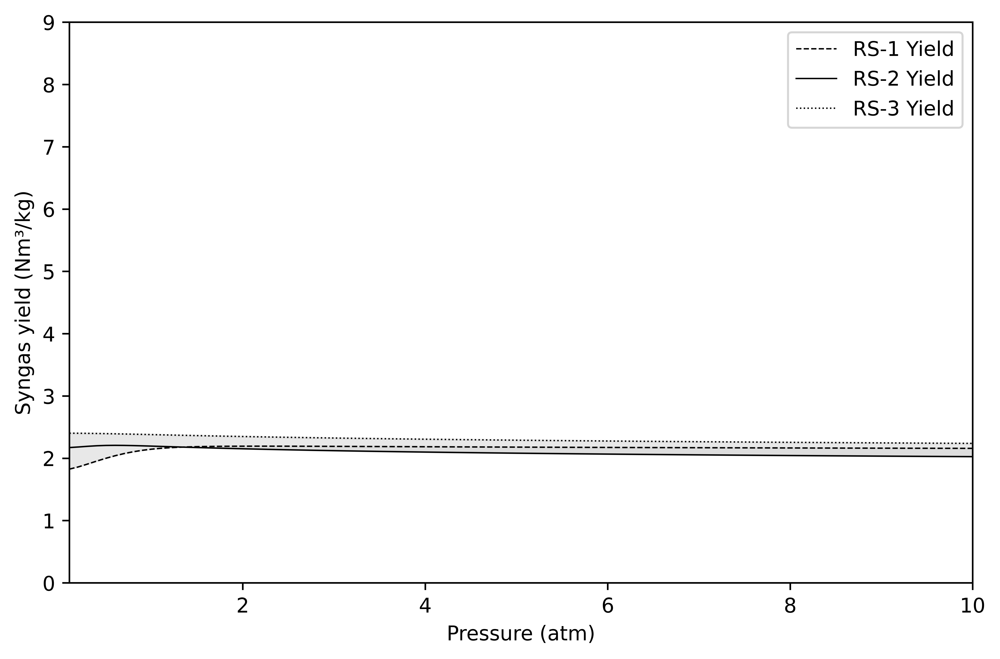

In [74]:
fig5_2, ax5_2a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax5_2a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax5_2a.set_ylim(0, 9)

ax5_2a.plot(Ps/ct.one_atm, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+"Yield", color='black')
ax5_2a.plot(Ps/ct.one_atm, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+"Yield", color='black')
ax5_2a.plot(Ps/ct.one_atm, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+"Yield", color='black')

ax5_2a.fill_between(Ps/ct.one_atm, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_P1], 
                  [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_P2], color='lightgray', alpha=0.5)
ax5_2a.fill_between(Ps/ct.one_atm, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_P2], 
                   [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_P3], color='lightgray', alpha=0.5)

ax5_2a.legend(loc='best')
ax5_2a.set_xlabel("Pressure (atm)")
ax5_2a.set_ylabel("Syngas yield (Nm³/kg)")

plt.savefig('figures/sensit_Eff_P_Yield.jpg')
plt.show()

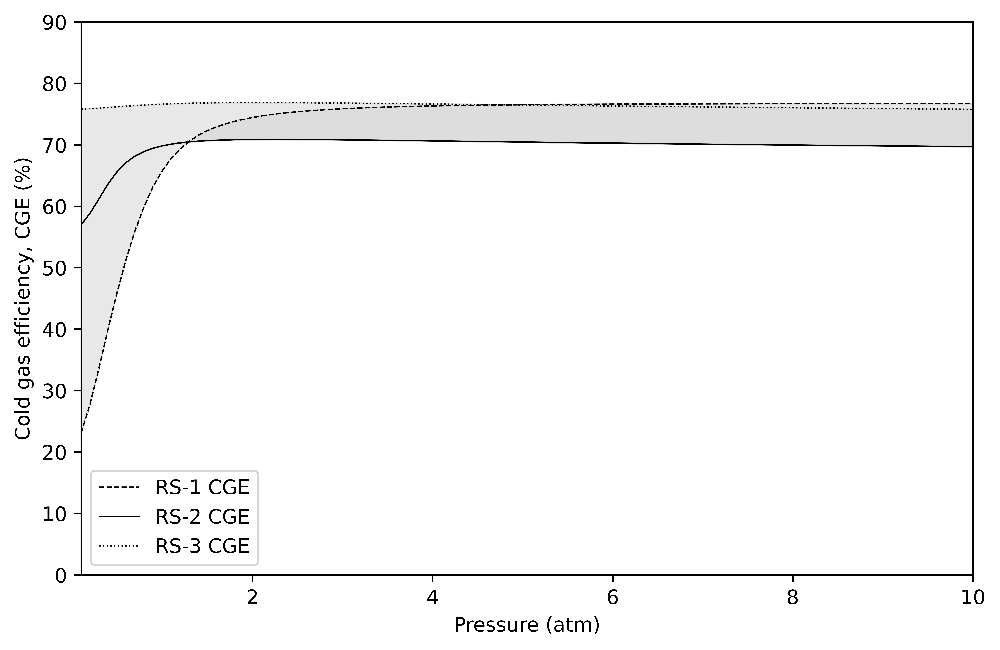

In [75]:
fig5_3, ax5_3a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax5_3a.set_xlim(0.1, Ps[-1]/ct.one_atm)
ax5_3a.set_ylim(0, 90)

ax5_3a.plot(Ps/ct.one_atm, [100*out.get_syngas_CGE() for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+"CGE", color='black')
ax5_3a.plot(Ps/ct.one_atm, [100*out.get_syngas_CGE() for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+"CGE", color='black')
ax5_3a.plot(Ps/ct.one_atm, [100*out.get_syngas_CGE() for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+"CGE", color='black')

ax5_3a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_CGE() for out in outs_by_P1], 
                  [100*out.get_syngas_CGE() for out in outs_by_P2], color='lightgray', alpha=0.5)
ax5_3a.fill_between(Ps/ct.one_atm, [100*out.get_syngas_CGE() for out in outs_by_P2], 
                   [100*out.get_syngas_CGE() for out in outs_by_P3], color='lightgray', alpha=0.5)

ax5_3a.legend(loc='best')
ax5_3a.set_xlabel("Pressure (atm)")
ax5_3a.set_ylabel("Cold gas efficiency, CGE (%)")

plt.savefig('figures/sensit_Eff_P_CGE.jpg')
plt.show()

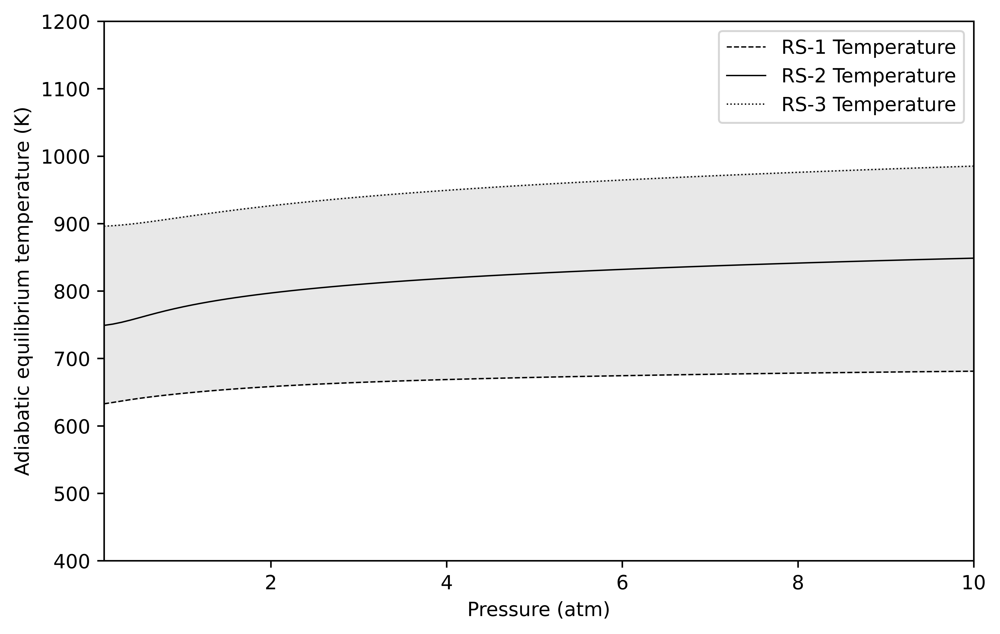

In [76]:
fig6, ax6a = plt.subplots(figsize=(8,5), dpi=1000)

ax6a.plot(Ps/ct.one_atm, [out.T for out in outs_by_P1], '--',  linewidth=0.7, label=leg[0]+'Temperature', color='black')
ax6a.plot(Ps/ct.one_atm, [out.T for out in outs_by_P2], '-',  linewidth=0.7, label=leg[1]+'Temperature', color='black')
ax6a.plot(Ps/ct.one_atm, [out.T for out in outs_by_P3], ':',  linewidth=0.7, label=leg[2]+'Temperature', color='black')

ax6a.fill_between(Ps/ct.one_atm, [out.T for out in outs_by_P1],
                  [out.T for out in outs_by_P2], color='lightgray', alpha=0.5)
ax6a.fill_between(Ps/ct.one_atm, [out.T for out in outs_by_P2], 
                  [out.T for out in outs_by_P3], color='lightgray', alpha=0.5)

plt.legend(loc='best')
plt.xlabel('Pressure (atm)')
plt.ylabel('Adiabatic equilibrium temperature (K)')
plt.xlim(0.1, Ps[-1]/ct.one_atm)
plt.ylim(400, 1200)
plt.savefig('figures/sensit_Temp_P.jpg')
plt.show()

In [77]:
moists = np.arange(0, 100, 1) / 100
outs_by_moist1 = []

for i, m in enumerate(moists):
    fuel1.set_moisture(m)
    outlet = gs.gasify_nonisot(fuel1, optAir1, T0=T0, P=P0, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_moist1.append(outlet)

In [78]:
outs_by_moist2 = []

for i, m in enumerate(moists):
    fuel2.set_moisture(m)
    outlet = gs.gasify_nonisot(fuel2, optAir2, T0=T0, P=P0, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_moist2.append(outlet)

In [79]:
outs_by_moist3 = []

for i, m in enumerate(moists):
    fuel3.set_moisture(m)
    outlet = gs.gasify_nonisot(fuel3, optAir3, T0=T0, P=P0, heatLossFraction=0, charFormation=0, directMethaneConv=0)
    outs_by_moist3.append(outlet)

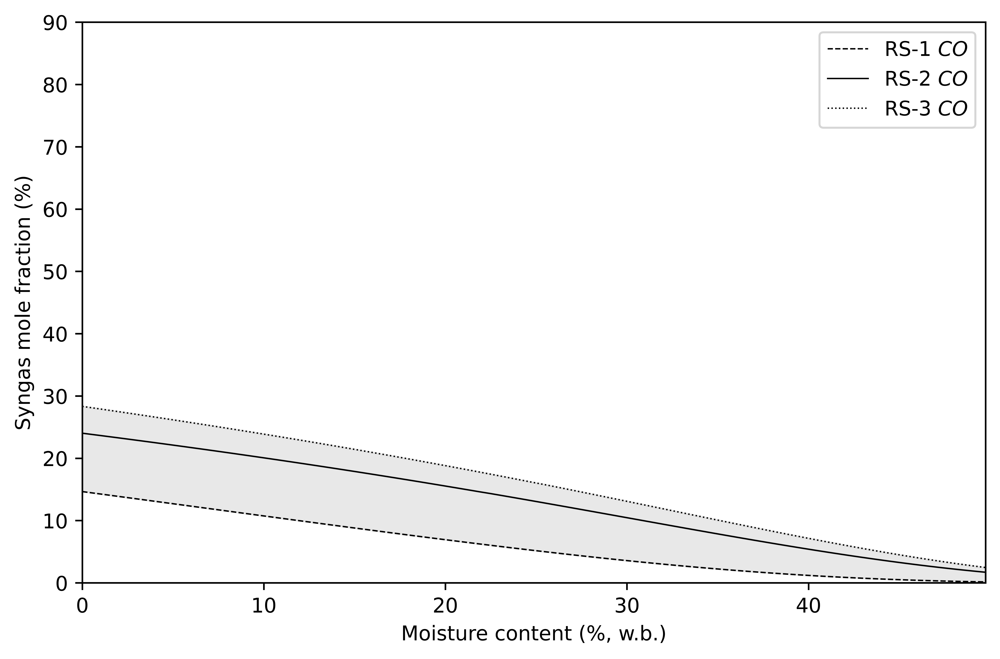

In [80]:
fig7_1, ax7_1a = plt.subplots(figsize=(8,5), dpi=1000)
moistsWB = moists / (1 + moists)

ax7_1a.plot(100*moistsWB, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+'$CO$', color='black')
ax7_1a.plot(100*moistsWB, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+'$CO$', color='black')
ax7_1a.plot(100*moistsWB, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+'$CO$', color='black')

ax7_1a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_moist1], 
                  [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax7_1a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_moist2], 
                  [100*out.get_syngas_fraction('CO', water=True, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax7_1a.legend(loc='upper right')
ax7_1a.set_xlabel('Moisture content (%, w.b.)')
ax7_1a.set_ylabel('Syngas mole fraction (%)')
ax7_1a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax7_1a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_Moist_CO.jpg')

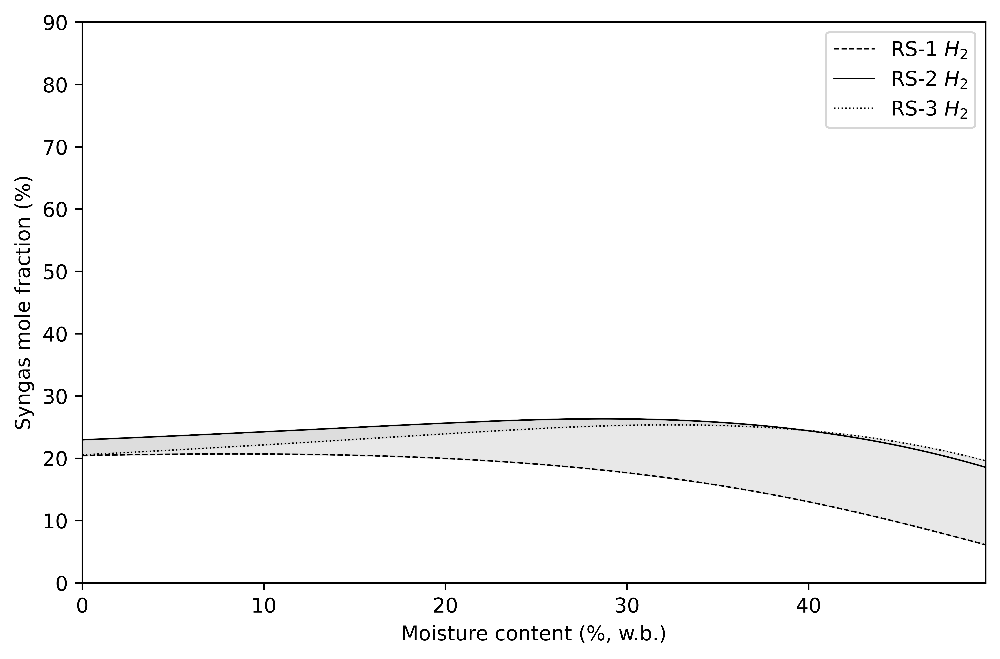

In [81]:
fig7_2, ax7_2a = plt.subplots(figsize=(8,5), dpi=1000)
moistsWB = moists / (1 + moists)

ax7_2a.plot(100*moistsWB, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+'$H_2$', color='black')
ax7_2a.plot(100*moistsWB, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+'$H_2$', color='black')
ax7_2a.plot(100*moistsWB, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+'$H_2$', color='black')

ax7_2a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_moist1], 
                  [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax7_2a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_moist2], 
                  [100*out.get_syngas_fraction('H2', water=True, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax7_2a.legend(loc='upper right')
ax7_2a.set_xlabel('Moisture content (%, w.b.)')
ax7_2a.set_ylabel('Syngas mole fraction (%)')
ax7_2a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax7_2a.set_ylim(0, siz)
plt.savefig('figures/sensit_Compos_Moist_H2.jpg')
plt.show()

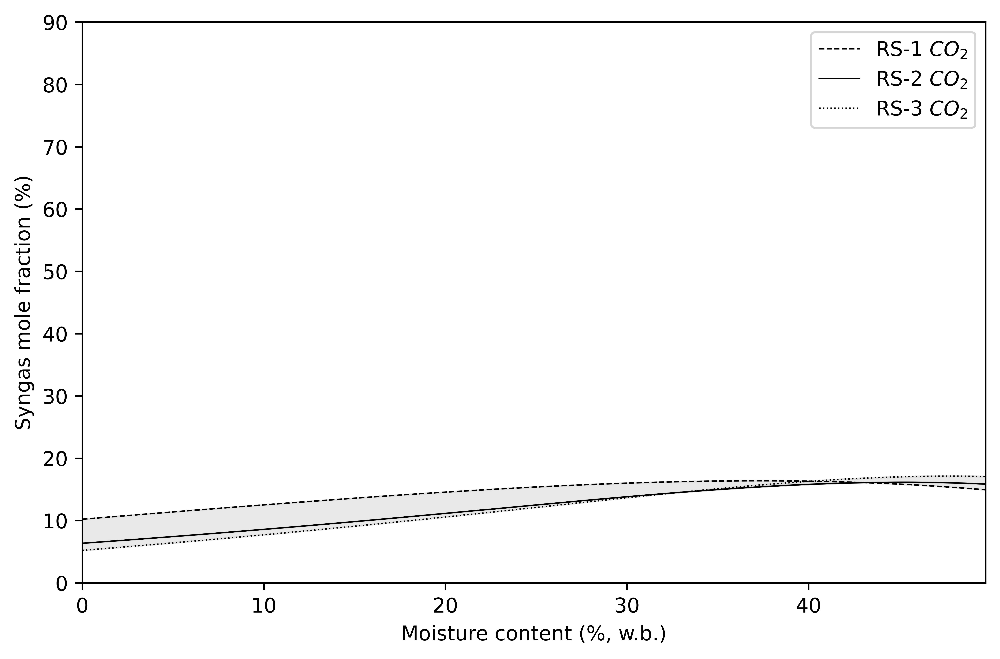

In [82]:
fig7_3, ax7_3a = plt.subplots(figsize=(8,5), dpi=1000)
moistsWB = moists / (1 + moists)

ax7_3a.plot(100*moistsWB, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+'$CO_2$', color='black')
ax7_3a.plot(100*moistsWB, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+'$CO_2$', color='black')
ax7_3a.plot(100*moistsWB, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+'$CO_2$', color='black')

ax7_3a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_moist1], 
                  [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax7_3a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_moist2], 
                  [100*out.get_syngas_fraction('CO2', water=True, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax7_3a.legend(loc='upper right')
ax7_3a.set_xlabel('Moisture content (%, w.b.)')
ax7_3a.set_ylabel('Syngas mole fraction (%)')
ax7_3a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax7_3a.set_ylim(0, siz)
plt.savefig('figures/sensit_Compos_Moist_CO2.jpg')
plt.show()

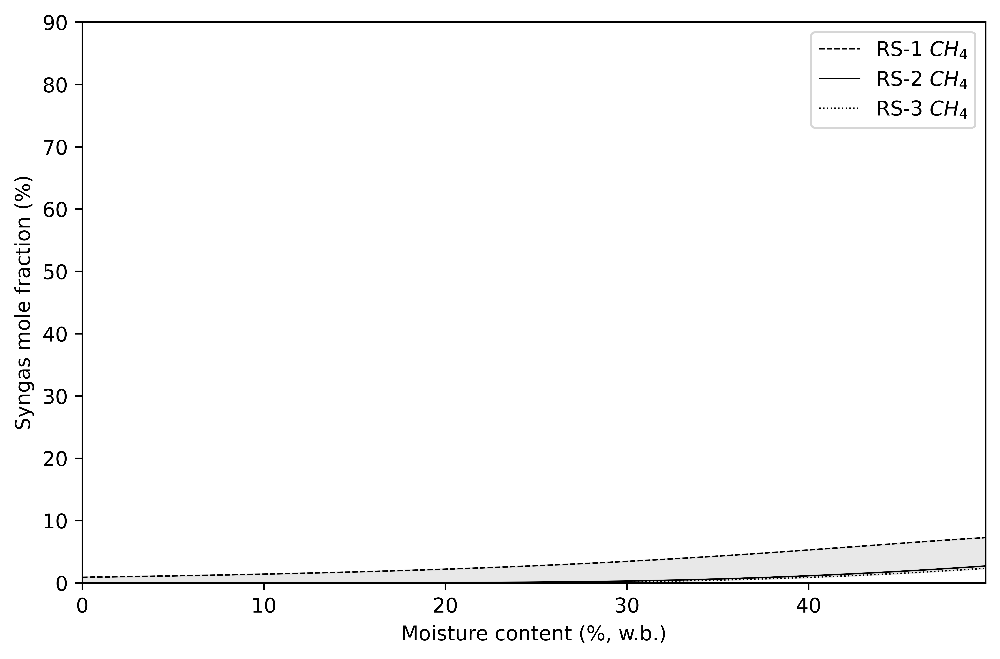

In [83]:
fig7_4, ax7_4a = plt.subplots(figsize=(8,5), dpi=1000)
moistsWB = moists / (1 + moists)

ax7_4a.plot(100*moistsWB, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+'$CH_4$', color='black')
ax7_4a.plot(100*moistsWB, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+'$CH_4$', color='black')
ax7_4a.plot(100*moistsWB, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+'$CH_4$', color='black')

ax7_4a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_moist1], 
                  [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax7_4a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_moist2], 
                  [100*out.get_syngas_fraction('CH4', water=True, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax7_4a.legend(loc='upper right')
ax7_4a.set_xlabel('Moisture content (%, w.b.)')
ax7_4a.set_ylabel('Syngas mole fraction (%)')
ax7_4a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax7_4a.set_ylim(0, siz)

plt.savefig('figures/sensit_Compos_Moist_CH4.jpg')
plt.show()

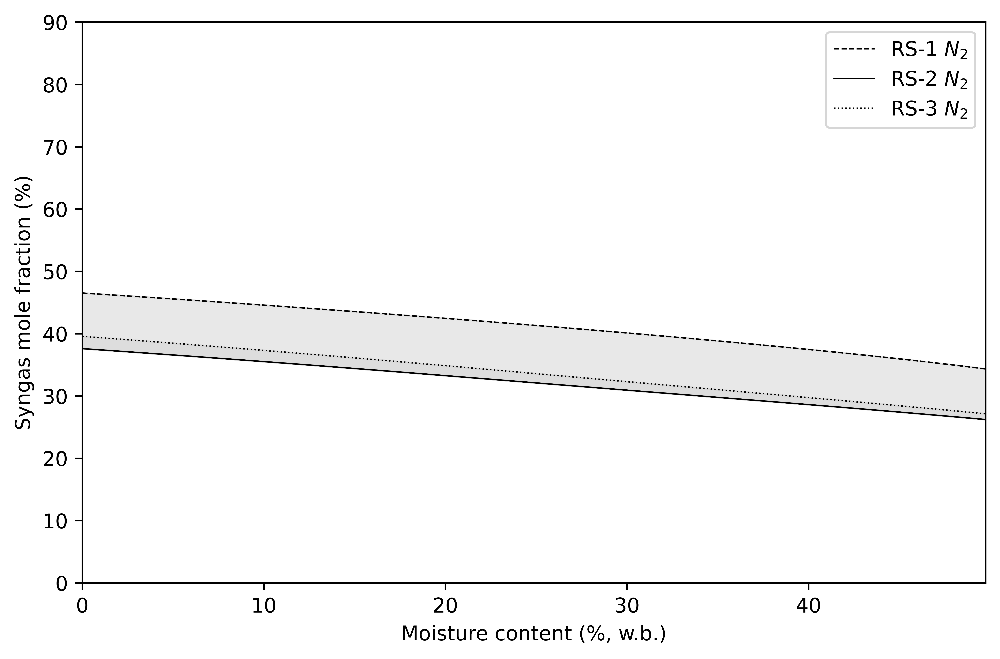

In [84]:
fig7_5, ax7_5a = plt.subplots(figsize=(8,5), dpi=1000)
moistsWB = moists / (1 + moists)

ax7_5a.plot(100*moistsWB, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+'$N_2$', color='black')
ax7_5a.plot(100*moistsWB, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+'$N_2$', color='black')
ax7_5a.plot(100*moistsWB, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+'$N_2$', color='black')

ax7_5a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_moist1], 
                  [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax7_5a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_moist2], 
                  [100*out.get_syngas_fraction('N2', water=True, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax7_5a.legend(loc='upper right')
ax7_5a.set_xlabel('Moisture content (%, w.b.)')
ax7_5a.set_ylabel('Syngas mole fraction (%)')
ax7_5a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax7_5a.set_ylim(0, siz)
plt.savefig('figures/sensit_Compos_Moist_N2.jpg')
plt.show()

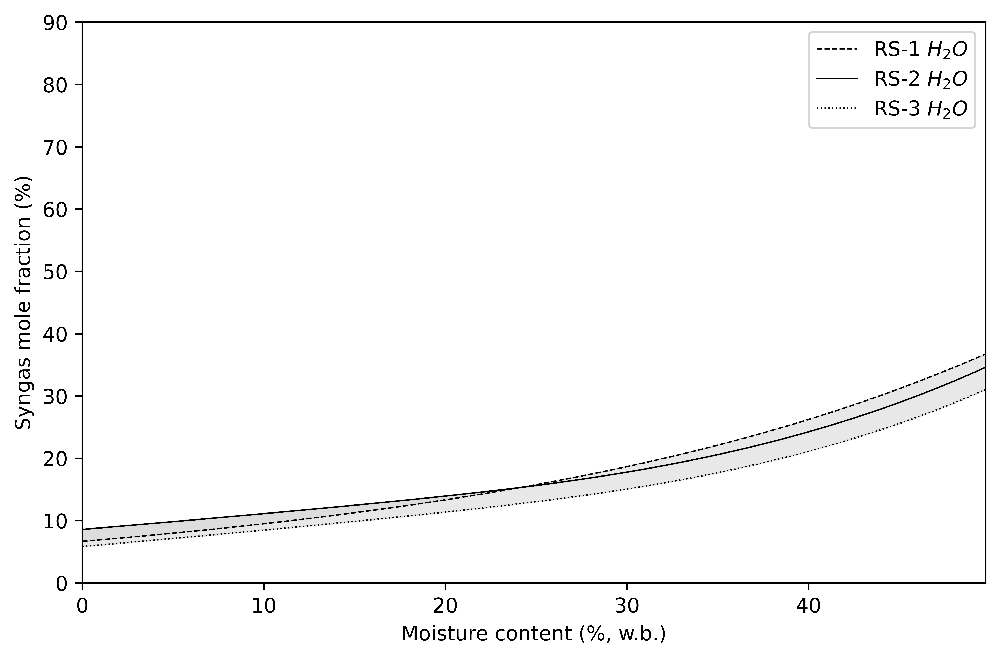

In [85]:
fig7_6, ax7_6a = plt.subplots(figsize=(8,5), dpi=1000)
moistsWB = moists / (1 + moists)

ax7_6a.plot(100*moistsWB, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+'$H_2O$', color='black')
ax7_6a.plot(100*moistsWB, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+'$H_2O$', color='black')
ax7_6a.plot(100*moistsWB, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+'$H_2O$', color='black')

ax7_6a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_moist1], 
                  [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax7_6a.fill_between(100*moistsWB, [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_moist2], 
                  [100*out.get_syngas_fraction('H2O', water=True, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax7_6a.legend(loc='upper right')
ax7_6a.set_xlabel('Moisture content (%, w.b.)')
ax7_6a.set_ylabel('Syngas mole fraction (%)')
ax7_6a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax7_6a.set_ylim(0, siz)
plt.savefig('figures/sensit_Compos_Moist_H2O.jpg')
plt.show()

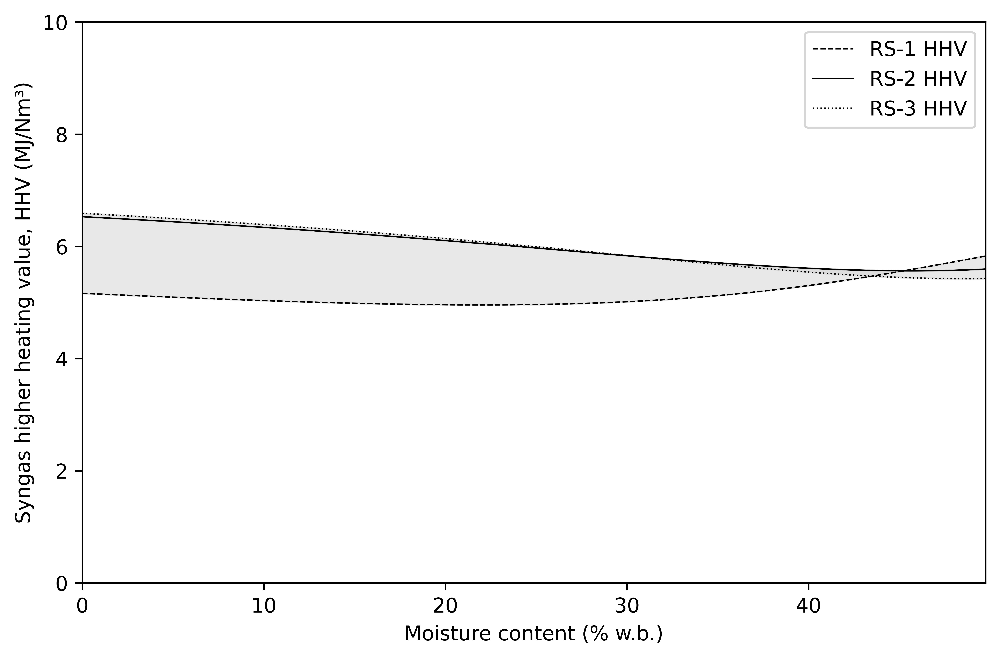

In [86]:
fig8_1, ax8_1a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax8_1a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax8_1a.set_ylim(0, 10)

ax8_1a.plot(100*moistsWB, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+"HHV", color='black')
ax8_1a.plot(100*moistsWB, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+"HHV", color='black')
ax8_1a.plot(100*moistsWB, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+"HHV", color='black')

ax8_1a.fill_between(100*moistsWB, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_moist1], 
                  [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax8_1a.fill_between(100*moistsWB, [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_moist2], 
                   [out.get_syngas_hhv(basis='vol', water=False, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax8_1a.legend(loc='best')
ax8_1a.set_xlabel("Moisture content (% w.b.)")
ax8_1a.set_ylabel("Syngas higher heating value, HHV (MJ/Nm³)")

plt.savefig('figures/sensit_Eff_P_HHV.jpg')
plt.show()

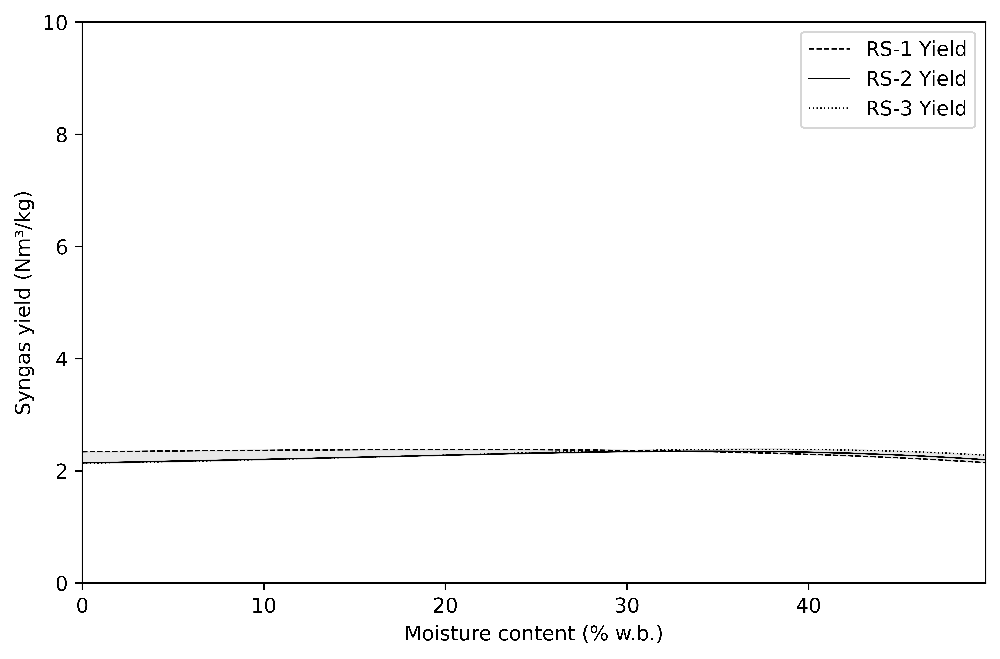

In [87]:
fig8_2, ax8_2a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax8_2a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax8_2a.set_ylim(0, 10)

ax8_2a.plot(100*moistsWB, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+"Yield", color='black')
ax8_2a.plot(100*moistsWB, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+"Yield", color='black')
ax8_2a.plot(100*moistsWB, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+"Yield", color='black')

ax8_2a.fill_between(100*moistsWB, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_moist1], 
                  [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax8_2a.fill_between(100*moistsWB, [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_moist2], 
                   [out.get_syngas_amount(basis='vol', water=False, nitrogen=True) for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax8_2a.legend(loc='best')
ax8_2a.set_xlabel("Moisture content (% w.b.)")
ax8_2a.set_ylabel("Syngas yield (Nm³/kg)")

plt.savefig('figures/sensit_Eff_P_Yield.jpg')
plt.show()

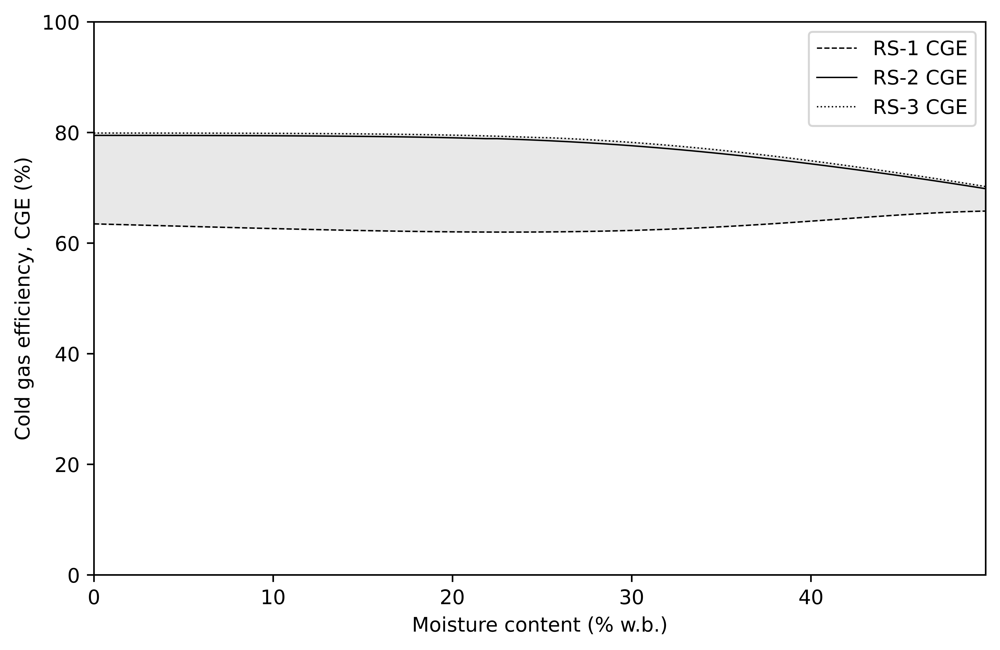

In [88]:
fig8_3, ax8_3a = plt.subplots(figsize=(8,5), dpi=1000) 
    
ax8_3a.set_xlim(100*moistsWB[0], 100*moistsWB[-1])
ax8_3a.set_ylim(0, 100)

ax8_3a.plot(100*moistsWB, [100*out.get_syngas_CGE() for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+"CGE", color='black')
ax8_3a.plot(100*moistsWB, [100*out.get_syngas_CGE() for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+"CGE", color='black')
ax8_3a.plot(100*moistsWB, [100*out.get_syngas_CGE() for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+"CGE", color='black')

ax8_3a.fill_between(100*moistsWB, [100*out.get_syngas_CGE() for out in outs_by_moist1], 
                  [100*out.get_syngas_CGE() for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax8_3a.fill_between(100*moistsWB, [100*out.get_syngas_CGE() for out in outs_by_moist2], 
                   [100*out.get_syngas_CGE() for out in outs_by_moist3], color='lightgray', alpha=0.5)

ax8_3a.legend(loc='best')
ax8_3a.set_xlabel("Moisture content (% w.b.)")
ax8_3a.set_ylabel("Cold gas efficiency, CGE (%)")

plt.savefig('figures/sensit_Eff_P_CGE.jpg')
plt.show()

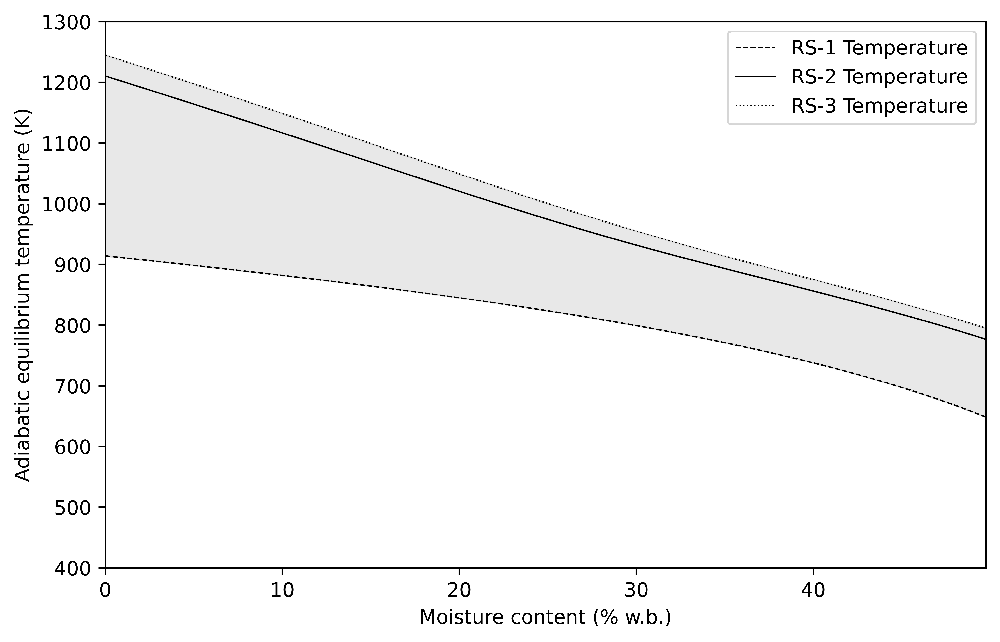

In [89]:
fig9, ax9a = plt.subplots(figsize=(8,5), dpi=1000)

ax9a.plot(moistsWB*100, [out.T for out in outs_by_moist1], '--',  linewidth=0.7, label=leg[0]+'Temperature', color='black')
ax9a.plot(moistsWB*100, [out.T for out in outs_by_moist2], '-',  linewidth=0.7, label=leg[1]+'Temperature', color='black')
ax9a.plot(moistsWB*100, [out.T for out in outs_by_moist3], ':',  linewidth=0.7, label=leg[2]+'Temperature', color='black')

ax9a.fill_between(moistsWB*100, [out.T for out in outs_by_moist1], 
                  [out.T for out in outs_by_moist2], color='lightgray', alpha=0.5)
ax9a.fill_between(moistsWB*100, [out.T for out in outs_by_moist2], 
                  [out.T for out in outs_by_moist3], color='lightgray', alpha=0.5)

plt.legend(loc='best')
plt.xlabel('Moisture content (% w.b.)')
plt.ylabel('Adiabatic equilibrium temperature (K)')
plt.xlim(moistsWB[0]*100, moistsWB[-1]*100)
plt.ylim(400, 1300)
plt.savefig('figures/sensit_Temp_Moist.jpg')
plt.show()